## 4. The Data

In [19]:
import os
import numpy as np
import pickle
import random
from collections import Counter
from datetime import datetime
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import math
import copy

In [20]:
def folder_list(path,label):
    '''
    PARAMETER PATH IS THE PATH OF YOUR LOCAL FOLDER
    '''
    filelist = os.listdir(path)
    review = []
    for infile in filelist:
        if infile.endswith(".txt"):
            file = os.path.join(path,infile)
            r = read_data(file)
            r.append(label)
            review.append(r)
        else:
            continue  
    return review



def read_data(file):
    '''
    Read each file into a list of strings. 
    Example:
    ["it's", 'a', 'curious', 'thing', "i've", 'found', 'that', 'when', 'willis', 'is', 'not', 'called', 'on', 
    ...'to', 'carry', 'the', 'whole', 'movie', "he's", 'much', 'better', 'and', 'so', 'is', 'the', 'movie']
    '''
    f = open(file,encoding='utf-8')
    lines = f.read().split(' ')
    symbols = '${}()[].,:;+-*/&|<>=~" '
    table = str.maketrans("a", "a", symbols)
    words = map(lambda Element: Element.translate(table).strip(), lines)
    words = list(filter(None, words))
    return words

###############################################
######## YOUR CODE STARTS FROM HERE. ##########
###############################################

def shuffle_data():
    '''
    pos_path is where you save positive review data.
    neg_path is where you save negative review data.
    '''
    pos_path = "/Users/sunevan/Dropbox/Spring 2017/Machine Learning/3/Assignment/data/pos"
    neg_path = "/Users/sunevan/Dropbox/Spring 2017/Machine Learning/3/Assignment/data/neg"

    pos_review = folder_list(pos_path,1)
    neg_review = folder_list(neg_path,-1)

    review = pos_review + neg_review
    random.shuffle(review)
    
    return review 

In [21]:
# choose the first 1500 for training data
df = shuffle_data()
train_df = df[:1500]
test_df = df[1500:]

In [24]:
X_train = list()
for i in range(len(train_df)):
    X_train.append(train_df[i][:-1])

    
X_test = list()
for i in range(len(test_df)):
    X_test.append(test_df[i][:-1])
    
y_train = list()
for i in range(len(train_df)):
    y_train.append(train_df[i][-1])

y_test = list()
for i in range(len(test_df)):
    y_test.append(test_df[i][-1])

In [25]:
X_train

[["'contact'",
  'shows',
  'why',
  'jodie',
  'foster',
  'is',
  'one',
  'of',
  'our',
  'best',
  'actresses',
  'see',
  'contact',
  'with',
  'your',
  'family',
  'it',
  'is',
  'a',
  'movie',
  'for',
  'all',
  'ages',
  'a',
  'review',
  'by',
  'stuart',
  'cracraft',
  'contact',
  'starring',
  'jodie',
  'foster',
  'matthew',
  'mcconaughey',
  'john',
  'hurt',
  'director',
  'robert',
  'zemeckis',
  'star',
  'after',
  'a',
  'predictable',
  'mit',
  'phillip',
  'morrison',
  'powersof10',
  'zoomout',
  'start',
  'which',
  'can',
  'be',
  'surprising',
  'to',
  'those',
  'not',
  'familiar',
  'with',
  'prof',
  "morrison's",
  'work',
  'contact',
  'picks',
  'up',
  'steam',
  'gradually',
  'building',
  'bytheend',
  'an',
  'irresistable',
  'juggernaut',
  'and',
  'a',
  'very',
  'good',
  'movie',
  'that',
  'does',
  'not',
  'as',
  'is',
  'so',
  'often',
  'the',
  'case',
  'fall',
  'outofbalance',
  'in',
  'terms',
  'of',
  'too',

In [23]:
df

[["'contact'",
  'shows',
  'why',
  'jodie',
  'foster',
  'is',
  'one',
  'of',
  'our',
  'best',
  'actresses',
  'see',
  'contact',
  'with',
  'your',
  'family',
  'it',
  'is',
  'a',
  'movie',
  'for',
  'all',
  'ages',
  'a',
  'review',
  'by',
  'stuart',
  'cracraft',
  'contact',
  'starring',
  'jodie',
  'foster',
  'matthew',
  'mcconaughey',
  'john',
  'hurt',
  'director',
  'robert',
  'zemeckis',
  'star',
  'after',
  'a',
  'predictable',
  'mit',
  'phillip',
  'morrison',
  'powersof10',
  'zoomout',
  'start',
  'which',
  'can',
  'be',
  'surprising',
  'to',
  'those',
  'not',
  'familiar',
  'with',
  'prof',
  "morrison's",
  'work',
  'contact',
  'picks',
  'up',
  'steam',
  'gradually',
  'building',
  'bytheend',
  'an',
  'irresistable',
  'juggernaut',
  'and',
  'a',
  'very',
  'good',
  'movie',
  'that',
  'does',
  'not',
  'as',
  'is',
  'so',
  'often',
  'the',
  'case',
  'fall',
  'outofbalance',
  'in',
  'terms',
  'of',
  'too',

## 5. Sparse Representations

### 5.1

In [5]:
def dotProduct(d1, d2):
    """
    @param dict d1: a feature vector represented by a mapping from a feature (string) to a weight (float).
    @param dict d2: same as d1
    @return float: the dot product between d1 and d2
    """
    if len(d1) < len(d2):
        return dotProduct(d2, d1)
    else:
        return sum(d1.get(f, 0) * v for f, v in d2.items())

In [6]:
def increment(d1, scale, d2):
    """
    Implements d1 += scale * d2 for sparse vectors.
    @param dict d1: the feature vector which is mutated.
    @param float scale
    @param dict d2: a feature vector.

    NOTE: This function does not return anything, but rather
    increments d1 in place. We do this because it is much faster to
    change elements of d1 in place than to build a new dictionary and
    return it.
    """
    for f, v in d2.items():
        d1[f] = d1.get(f, 0) + v * scale


In [7]:
def sparse_count(dataset):
    count_list = list()
    for i in dataset:
        count_list.append(dict(Counter(i)))
    return count_list

In [8]:
X_train_sparse = sparse_count(X_train)
X_test_sparse = sparse_count(X_test)

### 5.2 Optional - Blank

## 6. Support Vector Machine via Pegasos

### 6.2

In [9]:
def pegasos(X,y,Lambda,max_round = 100):
    t = 1 
    round_count = 0
    w = dict()
    while round_count < max_round:
        

        index_list = list(range(len(X))) 
        #random.shuffle(index_list) # shuffle everytime (Comment out so that I can compare for 6.4)
        round_count += 1 
        for i in index_list:
            t+= 1
            nt = 1/(t*Lambda)
            if y[i]*dotProduct(w,X[i]) < 1:
                increment(w,  -1 * nt * Lambda, w)
                increment(w,nt*y[i],X[i])
            else:
                increment(w,  -1 * nt * Lambda, w)
    
    return w 
        
                
                

### 6.3

In [10]:
def pegasos_1(X,y,Lambda,max_round = 100):
    t = 1
    s = 1 
    round_count = 0
    W = dict()
    
    while round_count < max_round:
        
        index_list = list(range(len(X))) 
        #random.shuffle(index_list) # shuffle everytime (Comment out so that I can compare for 6.4)
        round_count += 1 
        for i in index_list:
            t+= 1
            nt = 1/(t*Lambda)
            s = (1-nt * Lambda) * s 
            if y[i]*s*dotProduct(W,X[i]) < 1:
                increment(W,(1/s)*nt*y[i],X[i])
    
    increment(W,(s-1),W) #rescale w= W+(s-1)W

    return W

### 6.4

In [11]:
startTime = datetime.now()
p_1 = pegasos(X_train_sparse,y_train,0.1,1)
print ("Naive Algroithm runs:",datetime.now() - startTime)

Naive Algroithm runs: 0:00:10.390846


In [12]:
startTime = datetime.now()
p_2 = pegasos_1(X_train_sparse,y_train,0.1,1)
print ("Updated Algroithm runs:",datetime.now() - startTime)

Updated Algroithm runs: 0:00:00.381945


In [13]:
dotProduct(p_1,p_1)

32.98298580426625

In [14]:
dotProduct(p_2,p_2)

32.982985804269255

#### w is almost the same by running both algorithm. 

### 6.5

In [15]:
def predict_loss(w,X,y):
    loss = 0 
    for i in range(len(X)):
        pred = dotProduct(w,X[i])
        if pred * y[i] < 0:
            loss += 1 
    return loss / len(X)
    

### 6.6

In [16]:
# re-define pegasos by adding randomly shuffule data for mutilple round run 
def pegasos_2(X,y,Lambda,max_round = 50):
    t = 1
    s = 1 
    round_count = 0
    W = dict()
    
    while round_count < max_round:
        
        index_list = list(range(len(X))) 
        random.shuffle(index_list) # shuffle everytime 
        round_count += 1 
        for i in index_list:
            t+= 1
            nt = 1/(t*Lambda)
            s = (1-nt * Lambda) * s 
            if y[i]*s*dotProduct(W,X[i]) < 1:
                increment(W,(1/s)*nt*y[i],X[i])
    
    increment(W,(s-1),W) #rescale w= W+(s-1)W

    return W

In [446]:
w_list = list()
Lambda_list = list()
loss_list = list()

for i in range(-10,4):
    Lambda_list.append(10**i)
    w_inuse = pegasos_2(X_train_sparse,y_train,10**i)
    w_list.append(w_inuse)
    loss = predict_loss(w_inuse,X_test_sparse,y_test)
    loss_list.append(loss)

In [671]:
best_Lambda = Lambda_list[np.argmin((np.array(loss_list)))]
best_w = w_list[np.argmin((np.array(loss_list)))]
print ("Best Lambda to choose:", best_Lambda)
print ("Minimum loss is:",min(loss_list))

Best Lambda to choose: 1e-07
Minimum loss is: 0.198


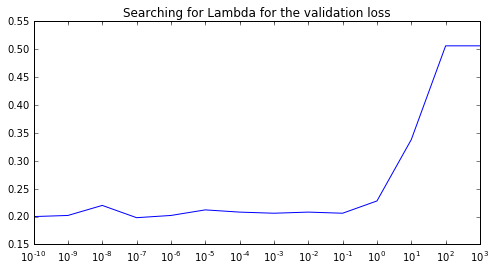

In [447]:
fig = plt.figure(figsize = (8,4))
plt.plot(Lambda_list,loss_list)
plt.xscale('log')
plt.title("Searching for Lambda for the validation loss")
plt.show()

#### It seems that when the validation loss increases whenever Lambda is greater than 1. Zoom in Lambda between 1e-12 and 1.

In [448]:
w_list_1 = list()
Lambda_list_1 = list()
loss_list_1 = list()

for i in np.linspace(-12,1,num = 50):
    Lambda_list_1.append(10**i)
    w_inuse = pegasos_2(X_train_sparse,y_train,10**i)
    w_list_1.append(w_inuse)
    loss = predict_loss(w_inuse,X_test_sparse,y_test)
    loss_list_1.append(loss)

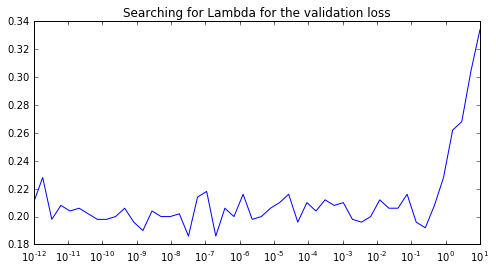

In [449]:
fig = plt.figure(figsize = (8,4))
plt.plot(Lambda_list_1,loss_list_1)
plt.xscale('log')
plt.title("Searching for Lambda for the validation loss")
plt.show()

In [672]:
best_Lambda_1 = Lambda_list_1[np.argmin((np.array(loss_list_1)))]
best_w_1 = w_list_1[np.argmin((np.array(loss_list_1)))]
print ("Best Lambda to choose:", best_Lambda_1)
print ("Minimum loss is:",min(loss_list_1))

Best Lambda to choose: 3.23745754282e-08
Minimum loss is: 0.186


### 6.7

In [599]:
pred_score_list = list()
pred_list = list()
abs_pred_score_list = list()
correction = list()
for i in range(len(X_test_sparse)):
    pred_score_list.append(dotProduct(best_w,X_test_sparse[i]))
    abs_pred_score_list.append(abs(dotProduct(best_w,X_test_sparse[i])))
    
    if dotProduct(best_w,X_test_sparse[i]) > 0:
        pred_list.append(1)
    else:
        pred_list.append(-1)
    
    if dotProduct(best_w,X_test_sparse[i])*y_test[i] > 0:
        correction.append(1)
    else:
        correction.append(0)


In [600]:
df = pd.DataFrame({"pred_score":pred_score_list,"prediction":pred_list,"y_test":y_test,"abs_pred_score":abs_pred_score_list,\
                   "correction":correction})
df = df.sort(columns="abs_pred_score",ascending=False)

correction_list=list()
max_abs_pred_score = list()
min_abs_pred_score = list()
for i in range(5):
    max_abs_pred_score.append(df.iloc[100*i:100*i+100].max()['abs_pred_score'])
    min_abs_pred_score.append(df.iloc[100*i:100*i+100].min()['abs_pred_score'])
    correction_list.append((df.iloc[100*i:100*i+100].sum()['correction'])/100) 

/Users/sunevan/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  from ipykernel import kernelapp as app


In [562]:
dff = pd.DataFrame({"max_absoulte_pred_score":max_abs_pred_score,"min_absoulte_pred_score":min_abs_pred_score,"correction_pct":correction_list})

dff

,correction_pct,max_absoulte_pred_score,min_absoulte_pred_score
0,0.99,4.612200e+06,1.437323e+06
1,0.93,1.415083e+06,8.982237e+05
2,0.80,8.928698e+05,5.045044e+05
3,0.71,5.028570e+05,2.524581e+05
4,0.64,2.520463e+05,3.294723e+03


#### So, I group the prediction score into 5 groups by the ranking of the absolute value. As seen in the table, for the prediction score between 4.6 e6 and 1.4 e6, there is only 1 out of 100 texts were predicted to be wrong. The correction %  gradually decreses when the score is lower. Also, I guess my prediction score is large due to a small Lambda I choose. 


### 6.8

In [726]:
count_1 = 0 
total_count =0 
for i in X_test_sparse:
    for key in i:
        w = best_w[key] if (key in best_w.keys()) else np.nan 
        x = i[key]
        if abs(x*w) <=1.1 and abs(x*w) >= 0.9:
            count_1+=1
        total_count+=1 

print (count_1, total_count)

0 167716


#### It is not surprising to see the result as my Lambda is set to low (which increases the prediction score). I think it is reasonable to skip update when it is equal to 1. However, if the optimal Lambda is close 0 or even larger, then it may not be a good idea. 

## 7.1

By doing 6.7, i am going to use review indexed as 195 and index 337 for the analysis

In [729]:
def error_analysis(indexnum):
    print ("This is No.",indexnum,"in the test set")
    
    if dotProduct(best_w,X_test_sparse[indexnum]) > 0:
        predict_v = 1
    else:
        predict_v = -1 
    
    print ("prediction score:",predict_v)    
    print ("y label:",y_test[indexnum])
    
    dict_xw = dict()
    for key in X_test_sparse[indexnum]:
        w = best_w[key] if (key in best_w.keys()) else np.nan 
        x = X_test_sparse[indexnum][key]
        dict_xw[key] = {"abs_xw":abs(x*w),"x":x,"w":w,"xw":(x*w)}
    dict_xw_df = pd.DataFrame.from_dict(dict_xw,'index')
    print(dict_xw_df.sort(columns='abs_xw',ascending=False)[:50],"\n")
    print (' '.join(X_test[indexnum]))

In [730]:
error_analysis(337)

This is No. 337 in the test set
prediction score: 1
y label: -1
                     xw             w    x         abs_xw
and       532659.564541  11333.182224   47  532659.564541
the       243196.757376   2133.304889  114  243196.757376
a        -181864.241811  -4133.278223   44  181864.241811
on       -143731.416915 -13066.492447   11  143731.416915
is        118798.416022   3599.952001   33  118798.416022
most      116265.116465  14533.139558    8  116265.116465
at       -107198.570686  -8933.214224   12  107198.570686
by        101998.640018   6799.909335   15  101998.640018
to        -86398.848016  -2399.968000   36   86398.848016
so        -81198.917348 -11599.845335    7   81198.917348
two       -80798.922682 -13466.487114    6   80798.922682
have      -77598.965347 -25866.321782    3   77598.965347
minutes   -73999.013346 -14799.802669    5   73999.013346
this      -65599.125345 -10933.187558    6   65599.125345
then      -64532.472900 -16133.118225    4   64532.472900
you     

/Users/sunevan/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:18: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


#### Analysis: This is a negative review and is predicted as a positive one. Even though "the" is relatively light weighted, a crazy 114 times apperance still helped a heavy positive weight in this case. In which, I guess I can try to remove stop words like "the", "and". Also, in this praticular case, the author used "most" for 8 times. However, it is used as a superlative in netural tone. 

In [731]:
error_analysis(195)

This is No. 195 in the test set
prediction score: -1
y label: 1
                       xw             w   x         abs_xw
and         271996.373383  11333.182224  24  271996.373383
this       -163997.813364 -10933.187558  15  163997.813364
you         107331.902242  21466.380448   5  107331.902242
on         -104531.939574 -13066.492447   8  104531.939574
the         100265.329795   2133.304889  47  100265.329795
a           -82665.564460  -4133.278223  20   82665.564460
two         -53865.948454 -13466.487114   4   53865.948454
plot        -51999.306676 -25999.653338   2   51999.306676
have        -51732.643565 -25866.321782   2   51732.643565
movie       -45732.723564  -6533.246223   7   45732.723564
to          -40799.456008  -2399.968000  17   40799.456008
if          -40266.129785 -20133.064893   2   40266.129785
mind         32399.568006  10799.856002   3   32399.568006
then        -32266.236450 -16133.118225   2   32266.236450
picture      31999.573339  10666.524446   3   31999

/Users/sunevan/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:18: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)


#### Analysis: This article used a few negative words like "apparently", "supposed", which sound negatively. In the orginal context, I think it is just the author's writing style to use meaningless adverb. So, probably a bigram can help solve the problem. 

## 8.1 

#### As analyzed above, I will try remove stop words and bi-gram to improve error rate. 
## Removing Stop Words

In [773]:
from stop_words import get_stop_words
stop_words = get_stop_words('english')

In [774]:
X_train_sparse_1 = sparse_count(X_train)
X_test_sparse_1 = sparse_count(X_test)

In [775]:
for i in X_train_sparse_1:
    for j in stop_words:
        try:
            i.pop(j, None)
        except:
            pass
for i in X_test_sparse_1:
    for j in stop_words:
        try:
            i.pop(j, None)
        except:
            pass        

In [776]:
w_list_2 = list()
Lambda_list_2 = list()
loss_list_2 = list()

for i in np.linspace(-12,1,num = 50):
    Lambda_list_2.append(10**i)
    w_inuse = pegasos_2(X_train_sparse_1,y_train,10**i)
    w_list_2.append(w_inuse)
    loss = predict_loss(w_inuse,X_test_sparse_1,y_test)
    loss_list_2.append(loss)

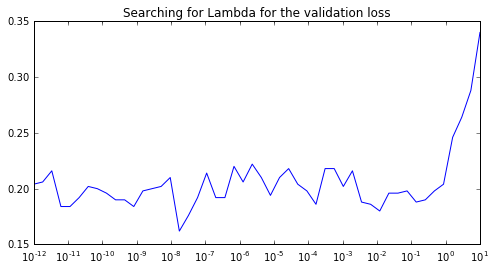

In [777]:
fig = plt.figure(figsize = (8,4))
plt.plot(Lambda_list_2,loss_list_2)
plt.xscale('log')
plt.title("Searching for Lambda for the validation loss")
plt.show()

In [778]:
best_Lambda_2 = Lambda_list_2[np.argmin((np.array(loss_list_2)))]
best_w_2 = w_list_2[np.argmin((np.array(loss_list_2)))]
print ("Best Lambda to choose:", best_Lambda_2)
print ("Minimum loss is:",min(loss_list_2))

Best Lambda to choose: 1.75751062485e-08
Minimum loss is: 0.162


In [779]:
print ("Minimum loss without removing stop words:",min(loss_list_1))

Minimum loss without removing stop words: 0.186


## bi-gram

In [783]:
def bigram(doc):
    bigram = list()

    for docc in doc:
        doc_dict = dict()
        for i in range(len(docc)):

            if i < len(docc)-1:
                key_inuse =(docc[i],docc[i+1]) 
                try:
                    doc_dict[key_inuse] = doc_dict[key_inuse]+1
                except:
                    doc_dict[key_inuse] = 1 
        bigram.append(doc_dict)
    return (bigram)

In [784]:
X_train_bigram = bigram(X_train)
X_test_bigram = bigram(X_test)

In [785]:
w_list_3 = list()
Lambda_list_3 = list()
loss_list_3 = list()

for i in np.linspace(-12,1,num = 50):
    Lambda_list_3.append(10**i)
    w_inuse = pegasos_2(X_train_bigram,y_train,10**i)
    w_list_3.append(w_inuse)
    loss = predict_loss(w_inuse,X_test_bigram,y_test)
    loss_list_3.append(loss)

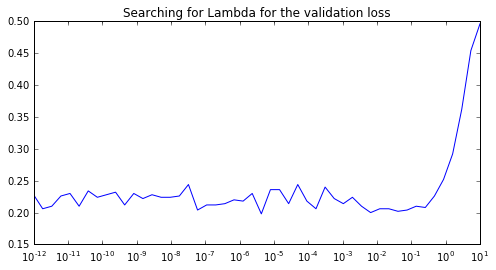

In [786]:
fig = plt.figure(figsize = (8,4))
plt.plot(Lambda_list_3,loss_list_3)
plt.xscale('log')
plt.title("Searching for Lambda for the validation loss")
plt.show()

In [787]:
best_Lambda_3 = Lambda_list_3[np.argmin((np.array(loss_list_3)))]
best_w_3 = w_list_3[np.argmin((np.array(loss_list_3)))]
print ("Best Lambda to choose:", best_Lambda_3)
print ("Minimum loss is:",min(loss_list_3))

Best Lambda to choose: 4.29193426013e-06
Minimum loss is: 0.198


#### So, after removing the stop words, the best error rate is 0.162. The original standard error is 0.01740. The new standard error is 0.0164.  It seems that removing stop words doesn't signficantly improve the rate. And, when using bi-gram instead of single word, the error rate is even higher. 